<a href="https://colab.research.google.com/github/OswaldFlores/Interpretable-Machine-Learning-with-Python/blob/master/Copy_of_UsedCars.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Used Cars Price Prediction
#### CHAPTER 4: _Global Model-Agnostic Interpretation Methods_
##### From **Interpretable Machine Learning with Python 2nd Edition** by Serg Masís, published by Packt

> we will explore the notion of feature importance by examining the model’s inherent parameters. Following that, we will study how to employ permutation feature importance in a model-agnostic manner to effectively, reliably, and autonomously rank features. Finally, we will outline how SHapley Additive exPlanations (SHAP) can rectify some of the shortcomings of permutation feature importance.


### This notebook will focus on:
- What is feature importance
- Gauging feature importance with model-agnostic methods
- Using SHAP, PDP, and ALE plots to visualize:
    - Global explanations
    - Feature summary explanations
    - Feature interactions

### The Approach
1. Train a couple of models
2. Evaluate them
3. Create feature importance values using several methods, both model-specific and model-agnostic
4. Plot global summaries, feature summaries, and feature interaction plots to understand how these features relate to the outcome and each other

The plots will help you communicate the findings

## The Preparations

### Installing the Libraries

### Loading the Libraries

In [ ]:
! pip install machine_learning_datasets
! pip install shap
! pip install pdpbox
! pip install PyALE
! pip install lime

In [ ]:
! pip install catboost

In [4]:
import math
import os, random
import numpy as np
import pandas as pd
import machine_learning_datasets as mldatasets

from sklearn import metrics, ensemble, tree, inspection, model_selection
import catboost as cb

import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import shap
from pdpbox import pdp, info_plots
from PyALE import ale
from lime.lime_tabular import LimeTabularExplainer

### Understanding and Preparing the Data

In [5]:
usedcars_df = mldatasets.load("usedcars", prepare=True)

https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python-2E/raw/main/datasets/usedcars-2e.csv.zip downloaded to /content/data/usedcars-2e.csv.zip
/content/data/usedcars-2e.csv.zip uncompressed to /content/data/usedcars-2e.csv
1 dataset files found in /content/data/usedcars-2e.csv folder
parsing /content/data/usedcars-2e.csv/usedcars_imputed.csv


In [6]:
usedcars_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   price                            256065 non-null  int64  
 1   region                           256065 non-null  object 
 2   posting_date                     256065 non-null  object 
 3   lat                              256065 non-null  float64
 4   long                             256065 non-null  float64
 5   state                            256065 non-null  object 
 6   city                             256065 non-null  object 
 7   zip                              256065 non-null  object 
 8   make                             256065 non-null  object 
 9   make_cat                         256065 non-null  object 
 10  make_pop                         256065 non-null  float64
 11  model                            256065 non-null  ob

The data dictionary for the dataset is as follows:

**Variables related to the listing:**

- price: target, continuous, the price posted for the vehicle

- region: categorical, the region for the listing— usually this is a city, metropolitan area, or (for more rural areas) a portion of a state or a least populated state (out of 402)

- posting_date: datetime, the date and time of the posting (all postings are for a single month period in 2021 so you cannot observe seasonal patterns with it)

- lat: continuous, the latitude in decimal format
- long: continuous, the longitude in decimal format
- state: categorical, the two-letter state code (out of 51 including [DC])
- city: categorical, the name of the city (out of over 6,700)
- zip: nominal, the zip code (out of over 13,100)

**Variables related to the vehicle:**
- make: categorical, the brand or manufacturer of the vehicle (out of 37)
- make_cat: categorical, the category for the make (out of 5). It’s [obsolete] for makes no longer produced, such as “Saturn,” [luxury sports] for brands like “Ferrari,” and [luxury] for brands like “Mercedes-Benz.” Everything else is [regular] or [premium]. The only difference is that [premium] include brands like “Cadillac” and “Acura,” which are the high-end brands of car manufacturers in the [regular] category.
- make_pop: continuous, the relative popularity of the make in percentiles (0– 1)
- model: categorical, the model (out of over 17,000)
- model_premier: binary, whether the model is a luxury version/ trim of a model (if the model itself is not already high-end such as those in the luxury, luxury sports, or premium categories)
- year: ordinal, the year of the model (from 1984– 2022)
- make_yr_pop: continuous, the relative popularity of the make for the year it was made for in percentiles (0– 1)
- model_yr_pop: continuous, the relative popularity of the model for the year it was made in percentiles (0– 1)
- odometer: continuous, the reading in the vehicle’s odometer
- auto_trans: binary, whether the car has automatic transmission— otherwise, it is manual
- fuel: categorical, the type of fuel used (out of 5: [gas], [diesel], [hybrid], [electric] and [other])
- model_type: categorical (out of 13: [sedan], [SUV], and [pickup] are the three most popular, by far)
- drive: categorical, whether it’s four-wheel, front-wheel, or rear-wheel drive (out of 3: [4wd], [fwd] and [rwd])
- cylinders: nominal, the number of cylinders of the engine (from 2– 16). Generally, the more cylinders, the higher the horsepower
- title_status: categorical, what the title says about the status of the vehicle (out of 7 like [clean], [rebuilt], [unknown], [salvage], and [lien])
- condition: categorical, what the owner reported the condition of the vehicle to be (out of 7 like [good], [unknown], [excellent] and [like new])

**Variables related to the emissions of the vehicle:**

- epa_co2: continuous, tailpipe CO2 in grams/ mile. For models after 2013, it is based on EPA tests. For previous years, CO2 is estimated using an EPA emission factor (-1 = not vvailable)
- epa_displ: continuous, the engine displacement (in liters 0.6– 8.4)

**Variables related to the ZIP code of the listing:**
- zip_population: continuous, the population
- zip_density: continuous, the density (residents per sq. mile)
- est_households_medianincome_usd: continuous, the median household income

In [7]:
usedcars_orig_df = usedcars_df.copy()
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'fuel',\
                                                  min_recs=500, defcatname='other')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'make_cat')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'model_type',\
                                                  min_recs=500, defcatname='other')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'condition',\
                                                  min_recs=200, defcatname='other')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'drive')
usedcars_df = mldatasets.make_dummies_with_limits(usedcars_df, 'title_status',\
                                                  min_recs=500, defcatname='other')

> Get rid of uninformative variables

As for the make and model, we have the make and model popularity and category features.

In [8]:
usedcars_df.dtypes[lambda x: x == object].index.tolist()

['region', 'posting_date', 'state', 'city', 'zip', 'make', 'model']

In [9]:
usedcars_df = usedcars_df.select_dtypes(include=(int,float,np.uint8))

In [10]:
rand = 42
os.environ['PYTHONHASHSEED']=str(rand)
np.random.seed(rand)
random.seed(rand)

target_col = 'price'

X = usedcars_df.drop([target_col], axis=1)
y = usedcars_df[target_col]

X_train, X_test, y_train, y_test =\
        model_selection.train_test_split(X, y, test_size=0.25, random_state=rand)

> Transformed Dataset X

In [67]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256065 entries, 7316814884 to 7302338378
Data columns (total 52 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   lat                              256065 non-null  float64
 1   long                             256065 non-null  float64
 2   make_pop                         256065 non-null  float64
 3   model_premier                    256065 non-null  int64  
 4   year                             256065 non-null  int64  
 5   make_yr_pop                      256065 non-null  float64
 6   model_yr_pop                     256065 non-null  float64
 7   odometer                         256065 non-null  float64
 8   auto_trans                       256065 non-null  int64  
 9   cylinders                        256065 non-null  int64  
 10  epa_co2                          256065 non-null  float64
 11  epa_displ                        256065 non-null  fl

## Model Training & Evaluation

> Train CatBoost and Random Forest classifiers

In [11]:
cb_mdl = cb.CatBoostRegressor(depth=7, learning_rate=0.2,\
                               random_state=rand, verbose=False)
cb_mdl = cb_mdl.fit(X_train, y_train)

rf_mdl = ensemble.RandomForestRegressor(n_jobs=-1, random_state=rand)
rf_mdl = rf_mdl.fit(X_train.to_numpy(), y_train.to_numpy())

> CatBoost Classifier (Predicted VS Actual)

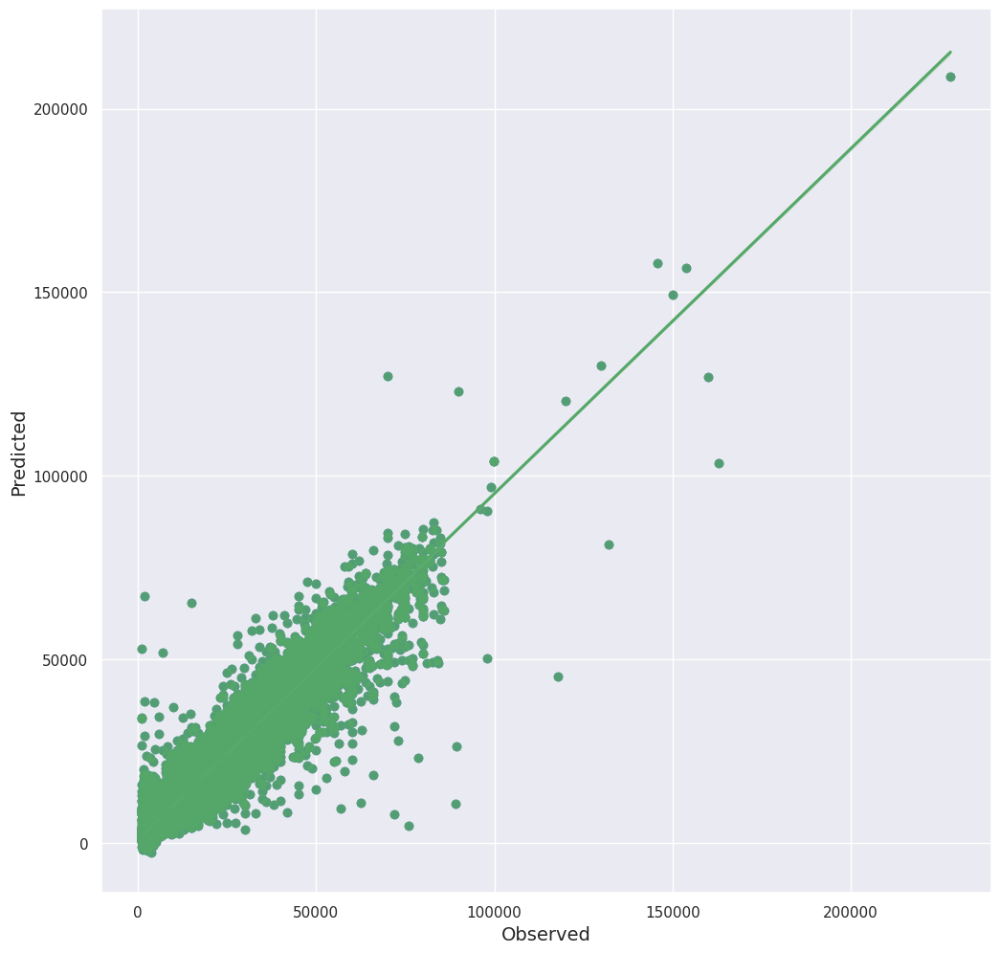

RMSE_train: 2543.4672	RMSE_test: 3099.8195	r2: 0.9444


In [69]:
mdl = cb_mdl

sns.set()
y_train_pred, y_test_pred =\
        mldatasets.evaluate_reg_mdl(mdl, X_train, X_test, y_train, y_test,
        )

> The CatBoost model produced a high R-squared of 0.94 and a test RMSE of nearly 3,100. The regression plot in Figure 4.1 tells us that although there are quite a few cases that have an extremely high error, the vast majority of the 64,000 test samples were predicted fairly well.

In [70]:
thresh = 4000
pct_under = np.where(np.abs(y_test - y_test_pred) < thresh, 1, 0).sum() / len(y_test)
print(f"Percentage of test samples under ${thresh:,.0f} in absolute error {pct_under:.1%}")

Percentage of test samples under $4,000 in absolute error 89.9%


> Random Forest Classifier (Predicted VS Actual)

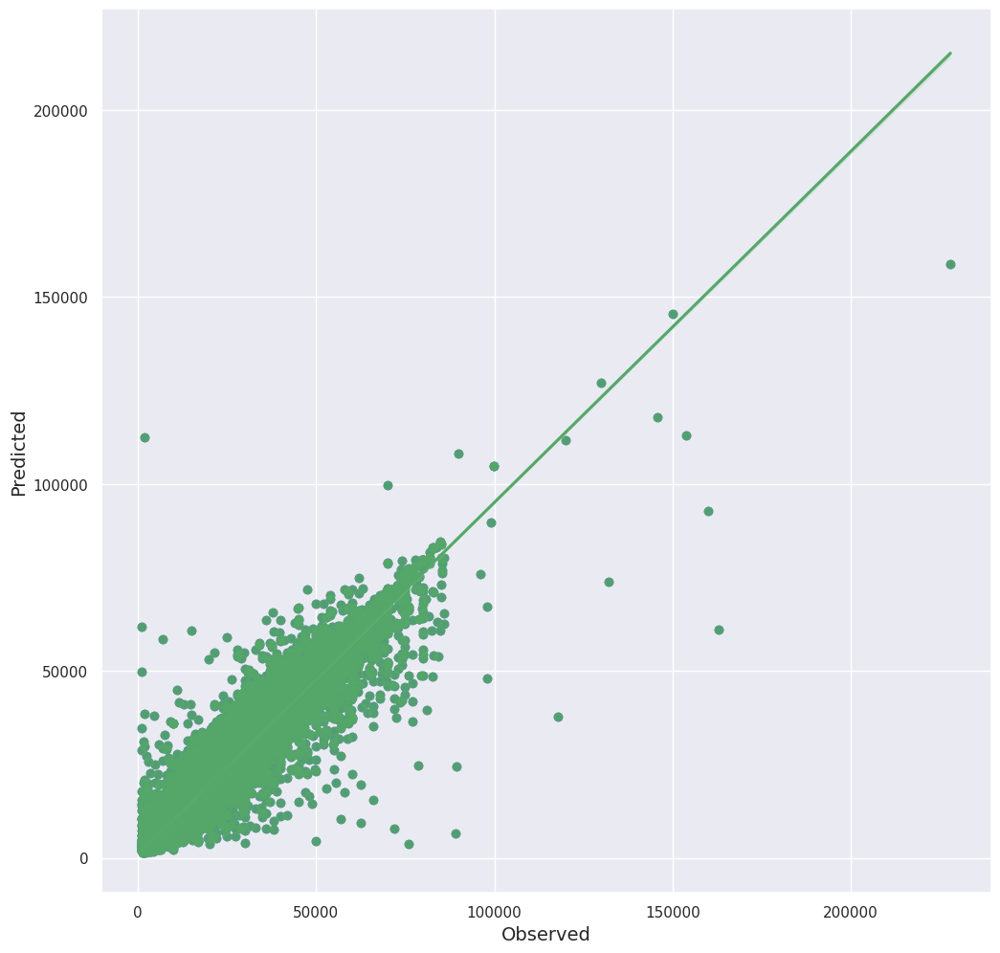

RMSE_train: 1158.2029	RMSE_test: 3074.9148	r2: 0.9453


In [14]:
mdl = rf_mdl

sns.set()
_, _ =\
        mldatasets.evaluate_reg_mdl(mdl, X_train, X_test, y_train, y_test)

> The Random Forest performs just as well for the test samples, and its metrics are remarkably similar to CatBoost, except it overfits much more in this case. This matters because we will now compare some feature importance methods on both and don’t want differences in predictive performance to be a reason to doubt any findings.

## What is feature importance?

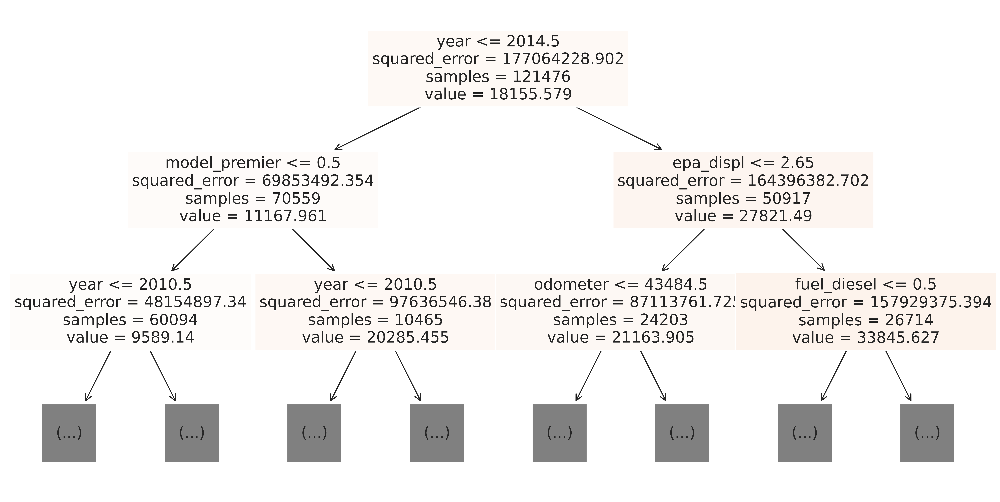

In [17]:
fig, axes = plt.subplots(nrows = 1, ncols = 1, figsize = (16,8), dpi=600)
tree.plot_tree(rf_mdl.estimators_[1], feature_names=X_train.columns,\
               filled = True, max_depth=2, fontsize=14)
fig.show()

> MSE is the impurity measure. It’s expected to decrease as you go deeper in the tree, so the sum of these weighted impurity decreases is calculated for each feature throughout the tree. How much a feature decreases node impurity indicates how much it contributes to the model’s outcome. This would be a model-specific method since it can’t be used with linear models or neural networks, but this is precisely how tree-based models compute feature importance. Random Forest is no different. However, it’s an ensemble, so it has a collection of estimators, so the feature importance is the mean decrease in impurity across all estimators.

In [18]:
rf_feat_imp = rf_mdl.feature_importances_
print(rf_feat_imp)

[8.27435826e-03 1.05316891e-02 2.41376641e-02 5.91421757e-02
 4.59888312e-01 2.36497116e-02 1.73254921e-02 9.41039384e-02
 1.13595842e-03 2.44903039e-02 1.52845147e-02 1.17932359e-01
 6.68909617e-03 7.26970607e-03 6.49519448e-03 3.73906562e-02
 3.35077351e-05 2.08595484e-03 1.06105564e-04 7.35524118e-04
 3.71629481e-03 1.37587550e-03 3.62514722e-05 1.35433058e-03
 1.85942291e-02 2.25594767e-03 4.58569071e-04 5.88135573e-04
 1.17333990e-04 3.57957275e-04 1.04637636e-03 1.85825529e-02
 3.04228803e-03 2.76059120e-03 6.61424708e-04 6.88477978e-05
 1.32533130e-03 5.57300537e-04 7.98286843e-03 7.95490983e-04
 1.21376943e-04 2.40284349e-05 1.40877926e-03 5.16139425e-03
 5.76593121e-03 1.65879364e-03 1.98557685e-03 1.89424809e-04
 3.60991098e-05 6.94700818e-04 2.98266787e-04 2.75408128e-04]


In [19]:
sum(rf_feat_imp)

0.9999999999999999

> CatBoost uses a different method to computer feature importance called : PredictionValuesChange. It shows how much, on average, the model outcome changes if the feature value changes. It traverses the tree performing a weighted average of feature contributions according to the number of nodes in each branch (left or right). If it encounters a combination of features in a node, it evenly assigns contributions to each one. As a result, it can yield misleading feature importance values for features that usually interact with one another.


In [20]:
cb_feat_imp = cb_mdl.feature_importances_
print(cb_feat_imp)

[1.23241338e+00 1.47250731e+00 5.10854175e+00 5.06215588e+00
 2.32428685e+01 2.49396877e+00 2.34425124e+00 1.30525170e+01
 3.62293240e-01 5.05852371e+00 4.02843847e+00 9.94625509e+00
 5.91470586e-01 6.56065556e-01 6.44118827e-01 6.15577710e+00
 4.52983204e-03 4.43591782e-01 1.97928036e-02 1.13317838e-01
 9.36855026e-01 7.15847753e-01 1.45702595e-02 1.50436254e-01
 3.20122608e+00 4.66538937e-01 4.35409660e-02 5.65100050e-02
 1.20649331e-02 7.26020698e-02 2.57216240e-01 3.41471177e+00
 8.61301597e-01 4.76814546e-01 1.41586247e-01 1.53973282e-02
 7.93089927e-02 1.52855942e-01 1.92784381e+00 9.89543927e-02
 5.87334128e-03 6.15126282e-03 4.08901733e-01 8.85913922e-01
 2.52940402e+00 3.18871605e-01 2.40918949e-01 2.57587858e-02
 3.64708812e-03 2.48937147e-01 1.27365951e-01 6.86744613e-02]


In [21]:
sum(cb_feat_imp)

100.0

In [22]:
feat_imp_df = pd.DataFrame({'feature':X_train.columns, 'cb_feat_imp':cb_feat_imp,\
                            'rf_feat_imp':rf_feat_imp*100})
feat_imp_df = feat_imp_df.sort_values('cb_feat_imp', ascending=False)
feat_imp_df.style.format('{:.2f}%', subset=['cb_feat_imp', 'rf_feat_imp']).\
                bar(subset=['cb_feat_imp', 'rf_feat_imp'], color='#4EF', width=60)

,feature,cb_feat_imp,rf_feat_imp
4,year,23.24%,45.99%
7,odometer,13.05%,9.41%
11,epa_displ,9.95%,11.79%
15,fuel_diesel,6.16%,3.74%
2,make_pop,5.11%,2.41%
3,model_premier,5.06%,5.91%
9,cylinders,5.06%,2.45%
10,epa_co2,4.03%,1.53%
31,model_type_pickup,3.41%,1.86%
24,make_cat_regular,3.20%,1.86%


> Notice that both models have the same most important feature in Figure 4.3. The top ten features are mostly the same but not in the same rank. In particular, odometer appears to be much more important for CatBoost than for Random Forest. Also, all the other features don’t match up in ranking except for the least important ones, for which there’s a consensus that they are indeed last: How can we address these differences and employ a technique that consistently represents a feature’s importance? We will explore this using model-agnostic approaches.

## Assessing Feature Importance with Model-agnostic Methods

Model-agnostic methods imply that we will not depend on intrinsic model parameters to compute feature importance. Instead, we will consider the model as a black box, with only the inputs and output visible. So, how can we determine which inputs made a difference?

What if we altered the inputs randomly? Indeed, one of the most effective methods for evaluating feature importance is through simulations designed to measure a feature’s impact or lack thereof. In other words, let’s remove a random player from the game and observe the outcome! In this section, we will discuss two ways to achieve this: permutation feature importance and SHAP.

### Permutation Feature Importance

Once we have a trained model, we cannot remove a feature to assess the impact of not using it. However, we can:

Replace the feature with a static value, such as the mean or median, rendering it devoid of useful information.

Shuffle (permute) the feature values to disrupt the relationship between the feature and the outcome.

Permutation feature importance (permutation_importance) uses the second strategy with a test dataset. Then it measures a change in the score (MSE, r2, f1, accuracy, etc.). In this case, a substantial decrease in the negative Mean Absolute Error (MAE) when the feature is shuffled would suggest that the feature has a high influence on the prediction. It would have to repeat the shuffling several times (n_repeats) to arrive at conclusive results by averaging out the decreases in accuracy. Please note the default scorer for Random Forest regressors is R-squared, while it’s RMSE for CatBoost, so we are making sure they both use the same scorer by setting the scoring parameter. The following code does all of this for both models

In [23]:
%%time
X_samp = X_test.sample(frac=0.3)
y_samp = y_test.loc[X_samp.index]

cb_perm_imp = inspection.permutation_importance(cb_mdl, X_samp, y_samp,\
                                                n_repeats=5, random_state=rand,\
                                                scoring='neg_mean_absolute_error')
rf_perm_imp = inspection.permutation_importance(rf_mdl, X_samp.to_numpy(),\
                                                y_samp.to_numpy(), n_repeats=5,\
                                                random_state=rand, scoring='neg_mean_absolute_error')

CPU times: user 5min 3s, sys: 2.9 s, total: 5min 6s
Wall time: 2min 56s


In [24]:
perm_imp_df = pd.DataFrame({'feature':X_train.columns, 'cb_perm_mean':cb_perm_imp.importances_mean,\
                            'cb_perm_std':cb_perm_imp.importances_std,\
                            'rf_perm_mean':rf_perm_imp.importances_mean,\
                            'rf_perm_std':rf_perm_imp.importances_std})
perm_imp_df = perm_imp_df.sort_values('cb_perm_mean', ascending=False)
perm_imp_df.style.format('{:.4f}', subset=['cb_perm_mean', 'cb_perm_std', 'rf_perm_mean', 'rf_perm_std']).\
                bar(subset=['cb_perm_mean', 'rf_perm_mean'], color='#4EF', width=60)

,feature,cb_perm_mean,cb_perm_std,rf_perm_mean,rf_perm_std
4,year,5469.6114,17.8537,6381.3891,14.3311
7,odometer,3029.2987,16.3274,3289.6996,22.4841
11,epa_displ,1330.7051,16.0213,2191.0799,25.1505
9,cylinders,1049.3324,10.0008,1217.5801,16.4082
2,make_pop,996.2043,7.1443,521.5881,6.8384
3,model_premier,580.0383,13.7382,1149.4696,15.5622
10,epa_co2,558.8655,3.1452,720.9986,14.3755
31,model_type_pickup,548.2176,8.2829,539.4135,4.2696
5,make_yr_pop,546.1205,3.6921,488.1375,6.4764
24,make_cat_regular,483.7597,5.6140,703.0490,12.2885


Permutation feature importance can be understood as the average increase in model error when a feature is made irrelevant, along with its interactions with other features. It is relatively fast to compute since models don’t need to be retrained, but its specific value should be taken with a grain of salt because there are some drawbacks to this shuffling technique:
- Shuffling a highly correlated feature with another unshuffled feature may not significantly affect predictive performance, as the unshuffled feature retains some information from the shuffled one. This means it cannot accurately assess the importance of multicollinear features.
- Shuffling can lead to unrealistic observations, like predicting vehicle traffic with weather and ending up with winter temperatures during the summer. This will result in a higher predictive error for a model that has never encountered such examples, overstating the importance scores beyond their actual significance.

Therefore, these importance values are only useful to rank the features and gauge their relative importance against other features in a particular model. We will now explore how Shapley values can help address these issues.

### SHAP Values

- Cooperative game theory: In this context, players form different sets called coalitions, and when they play, they get varying scores known as marginal contributions. The Shapley value is the average of these contributions across multiple simulations.

- In terms of feature importance, players represent features, sets of players symbolize sets of features, and marginal contribution is related to a decrease in predictive error.

This approach may seem similar to permutation feature importance, but its focus on feature combinations rather than individual features helps tackle the multicollinear issue. Moreover, the values obtained through this method satisfy several favorable mathematical properties, such as:

- Additivity: the sum of the parts adds to the total value
- Symmetry: consistent values for equal contributions
- Efficiency: equal to the difference between the prediction and expected value
- Dummy: a value of zero for features with no impact on the outcome


In practice, this method demands substantial computational resources. For instance, five features yield possible coalitions, while 15 features result in 32,768. Therefore, most Shapley implementations use shortcuts like Monte Carlo sampling or leveraging the model’s intrinsic parameters (which makes them model-specific). The SHAP library employs various strategies to reduce computational load without sacrificing Shapley properties too much.

#### Comprehensive Explanations with the KernelExplainer

> Within SHAP, the most prevalent model-agnostic approach is KernelExplainer, which is based on Local Interpretable Model-agnostic Explanations (LIME). Don’t fret if you don’t understand the specifics since we will cover it in detail in Chapter 5, Local Model-Agnostic Interpretation Methods. To cut down on computation, it employs sample coalitions. In addition, it follows the same procedures as LIME, such as fitting weighted linear models, but employs Shapley sample coalitions and a different kernel that returns SHAP values as coefficients.

KernelExplainer can be initialized with a kmeans background sample of the training dataset (X_train_summary), which helps it define the kernels. It can be still slow. Therefore, it’s better not to use large datasets to compute the shap_values. Instead, in the following code, we are using only 2% of the test dataset (X_test_sample)

In [25]:
%%time
rf_fn = lambda x: rf_mdl.predict(x)
X_train_summary = shap.kmeans(X_train.to_numpy(), 50)
X_test_sample = X_test.sample(frac=0.02)

rf_kernel_explainer = shap.KernelExplainer(rf_fn, X_train_summary)
rf_shap_values = rf_kernel_explainer.shap_values(X_test_sample.to_numpy(),\
                                                 nsamples=100)

  0%|          | 0/1280 [00:00<?, ?it/s]

CPU times: user 7min 13s, sys: 23.1 s, total: 7min 36s
Wall time: 6min 33s


In [71]:
print( rf_shap_values.shape)

(1280, 52)


Note that it’s two dimensions! There’s one SHAP value per observation x feature. For this reason, SHAP values can be used for both global and local interpretation. Put a pin in that!

#### Faster Explanations with TreeExplainer

> TreeExplainer was designed to efficiently estimate SHAP values for tree-based models such as XGBoost, Random Forest, and CART decision trees. It can allocate non-zero values to non-influential non-influential features because it employs the conditional expectation value function rather than marginal expectation, violating the Shapley dummy property. This can have consequences when features are collinear, potentially making explanations less reliable. However, it adheres to other properties.

In [26]:
%%time
cb_tree_explainer = shap.TreeExplainer(cb_mdl)
cb_shap_values = cb_tree_explainer.shap_values(X_test)

CPU times: user 32.3 s, sys: 702 ms, total: 33 s
Wall time: 20.1 s


In [75]:
print( cb_shap_values.shape)

(64017, 52)


> For feature importance values, we can collapse two dimensions into one. All we need to do is average the absolute value per feature like this:


In [27]:
cb_shap_imp = np.mean(np.abs(cb_shap_values),0)

In [28]:
rf_shap_imp = np.mean(np.abs(rf_shap_values),0)

In [29]:
shap_imp_df = pd.DataFrame({'feature':X_train.columns, 'cb_shap_imp':cb_shap_imp,\
                            'rf_shap_imp':rf_shap_imp})
shap_imp_df = shap_imp_df.sort_values('cb_shap_imp', ascending=False)
shap_imp_df.style.format('{:.4f}', subset=['cb_shap_imp', 'rf_shap_imp']).\
                bar(subset=['cb_shap_imp', 'rf_shap_imp'], color='#4EF', width=60)

,feature,cb_shap_imp,rf_shap_imp
4,year,5374.6635,5738.7776
7,odometer,3691.2966,2859.9585
11,epa_displ,1347.3157,1835.7228
9,cylinders,1125.1109,798.6064
3,model_premier,1123.7732,636.6388
2,make_pop,865.3036,385.6415
31,model_type_pickup,861.0232,652.0865
44,drive_fwd,837.2566,271.9131
24,make_cat_regular,767.6872,401.9973
15,fuel_diesel,676.5713,405.2332


## Visualize Global explanations

In [30]:
%%time
cb_explainer = shap.Explainer(cb_mdl)
cb_shap = cb_explainer(X_test)

CPU times: user 31 s, sys: 373 ms, total: 31.4 s
Wall time: 19 s


In [31]:
print(type(cb_explainer))

<class 'shap.explainers._tree.TreeExplainer'>


In [32]:
print("Values dimensions: %s" % (cb_shap.values.shape,))
print("Data dimensions:   %s" % (cb_shap.data.shape,))

Values dimensions: (64017, 52)
Data dimensions:   (64017, 52)


### SHAP Bar Plot

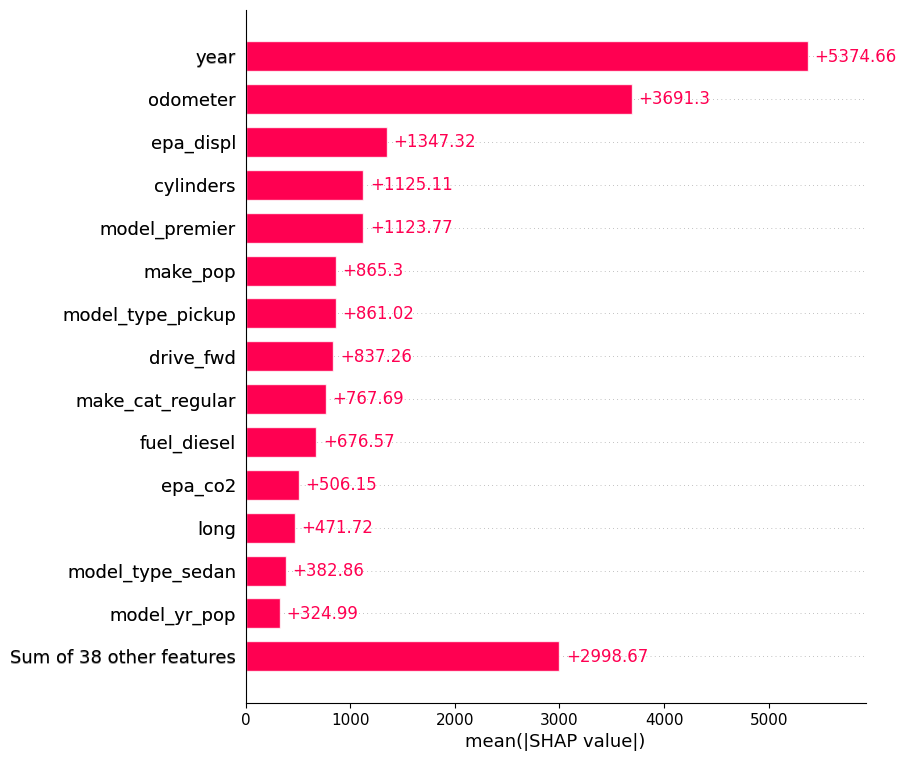

In [33]:
sns.reset_orig()
shap.plots.bar(cb_shap, max_display=15)

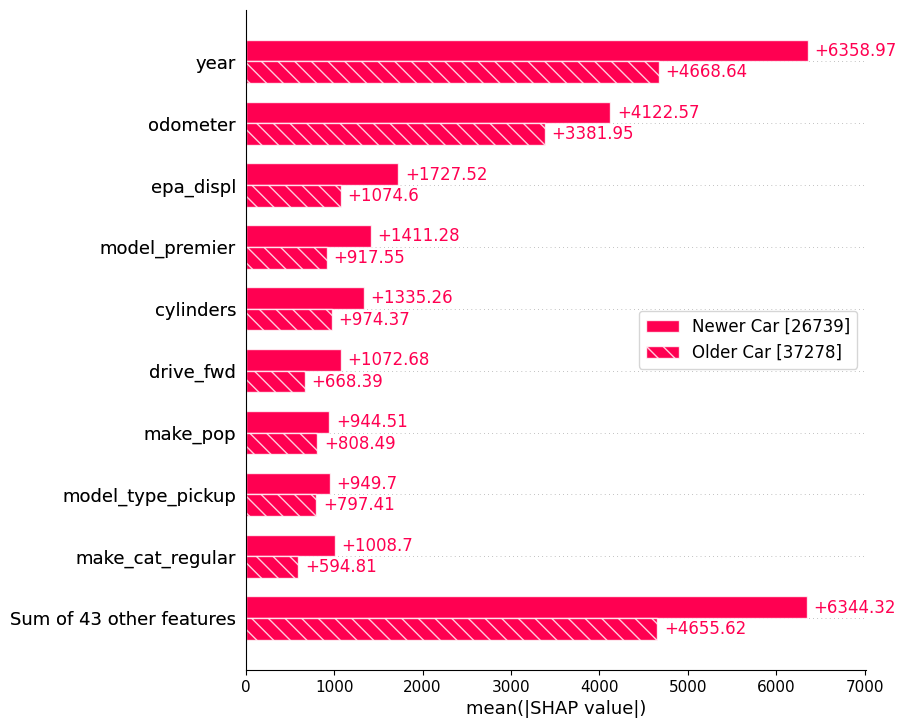

In [34]:
yr_cohort = np.where(X_test.year > 2014,\
                     "Newer Car", "Older Car")

shap.plots.bar(cb_shap.cohorts(yr_cohort).abs.mean(0))

### SHAP Beeswarm Plot

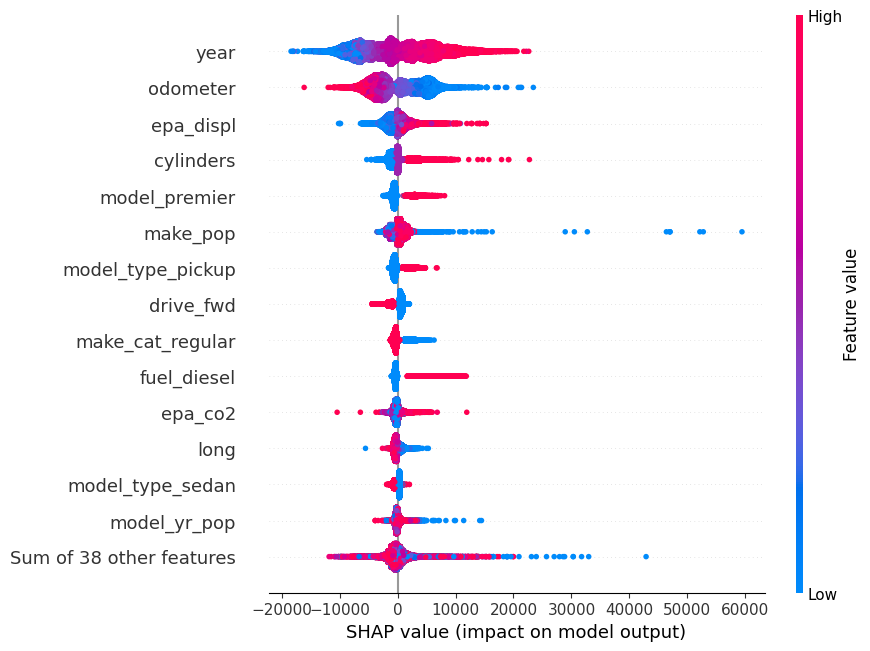

In [35]:
shap.plots.beeswarm(cb_shap, max_display=15)

## Feature summary explanations

### Partial Dependence Plot (PDP)

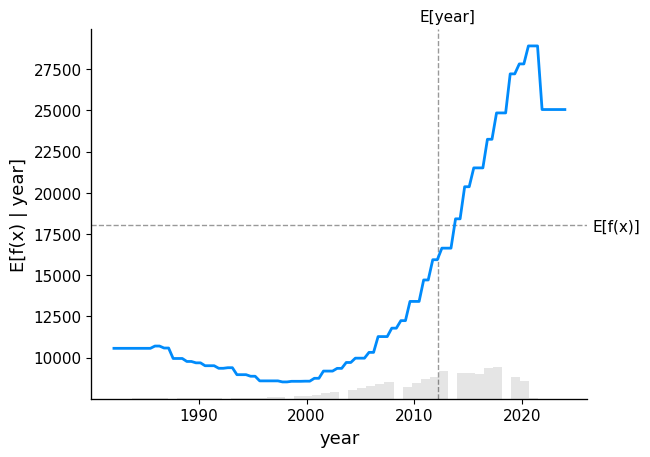

In [36]:
shap.plots.partial_dependence("year", cb_mdl.predict, X_test,\
                              ice=False, model_expected_value=True,\
                              feature_expected_value=True)

In [44]:
pdp_single_feature = pdp.PDPIsolate(
    model=cb_mdl, df=X_test, model_features=X_test.columns, feature='year',\
    feature_name='year', n_classes=0, n_jobs=-1
)
fig, axes = pdp_single_feature.plot(plot_pts_dist=True)
fig.show()
plt.show()


obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

In [42]:
fig, axes = pdp_single_feature.plot(plot_pts_dist=True, plot_lines=True,\
                                    frac_to_plot=0.01)
fig.show()

In [39]:
fig, axes = pdp_single_feature.plot(to_bins=True, plot_lines=True,\
                                    frac_to_plot=0.01, show_percentile=True)
fig.show()

In [40]:
cont_feature_l = ['year', 'odometer', 'cylinders', 'epa_displ',\
                  'make_pop', 'make_yr_pop', 'model_yr_pop']

make_cat_feature_l = ['make_cat_obsolete', 'make_cat_regular', 'make_cat_premium',\
                      'make_cat_luxury', 'make_cat_luxury_sports']

bin_feature_l = ['model_premier', 'auto_trans']

cat_feature_l = make_cat_feature_l + bin_feature_l

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

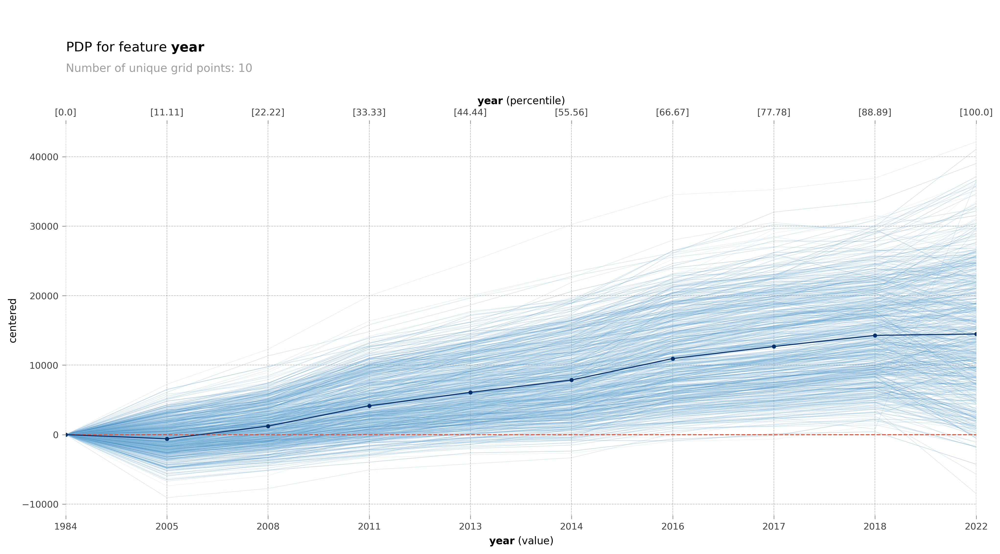

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

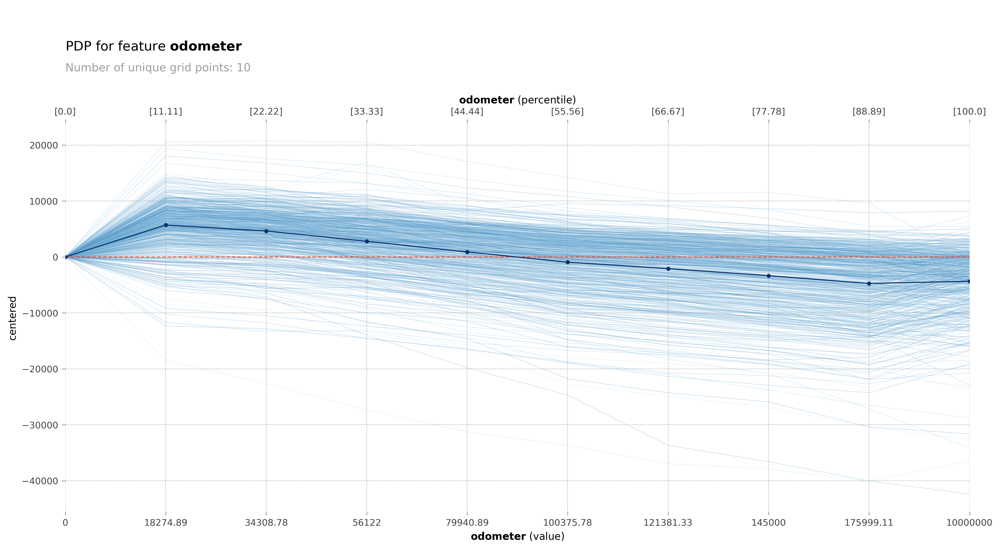

obtain pred_func from the provided model.


  0%|          | 0/5 [00:00<?, ?it/s]

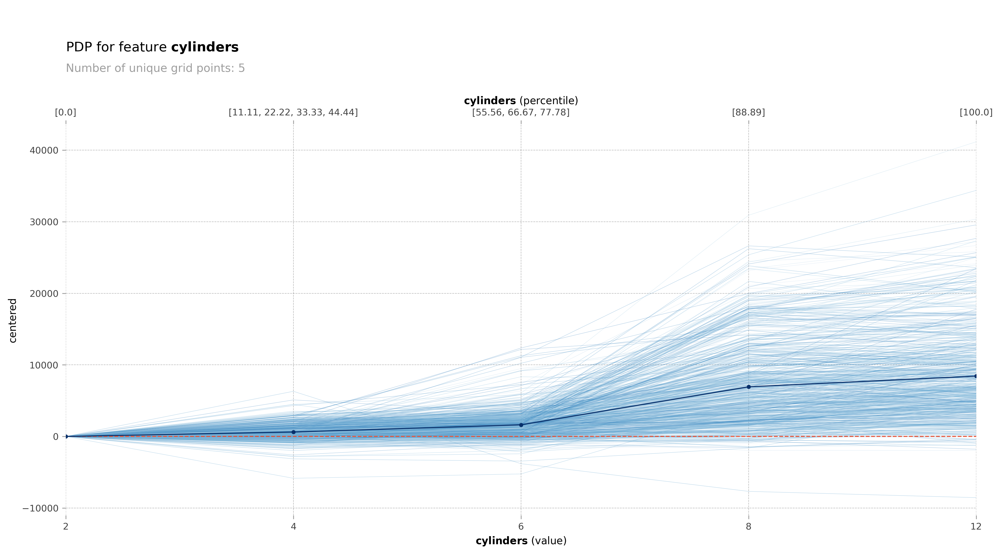

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

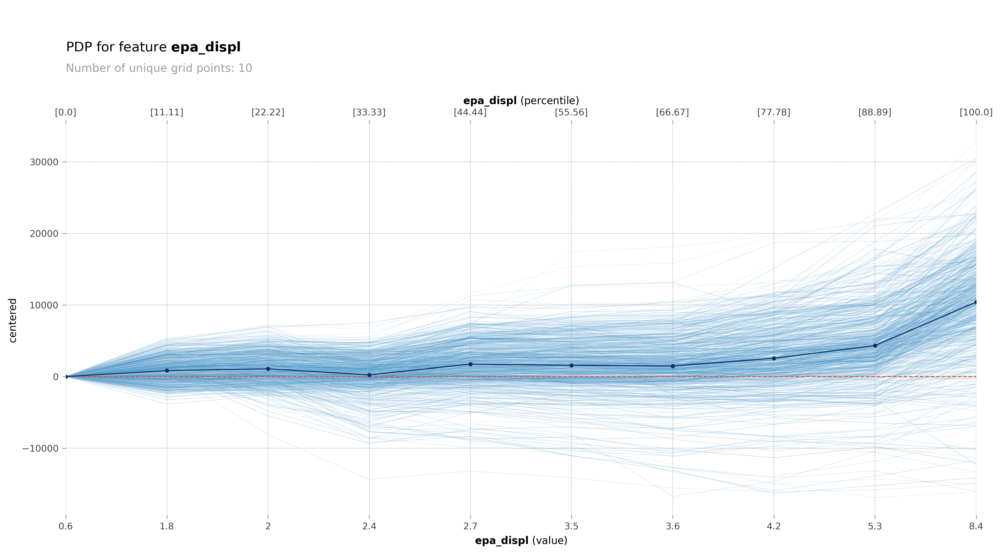

obtain pred_func from the provided model.


  0%|          | 0/9 [00:00<?, ?it/s]

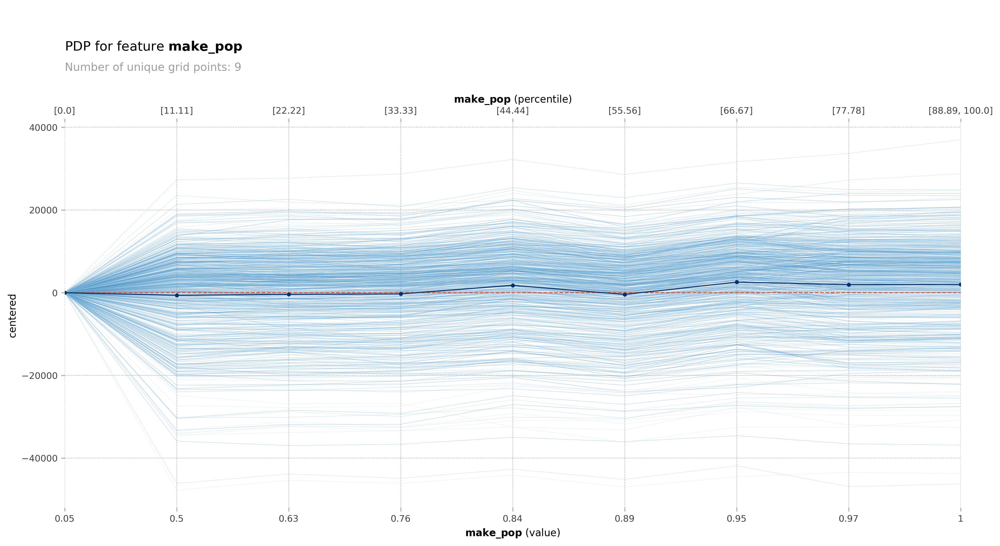

obtain pred_func from the provided model.


  0%|          | 0/9 [00:00<?, ?it/s]

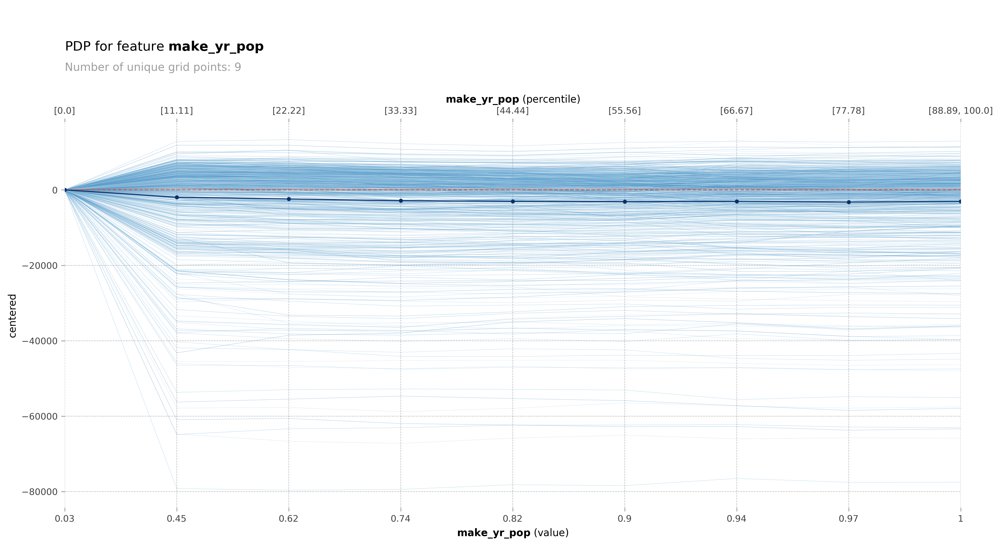

obtain pred_func from the provided model.


  0%|          | 0/10 [00:00<?, ?it/s]

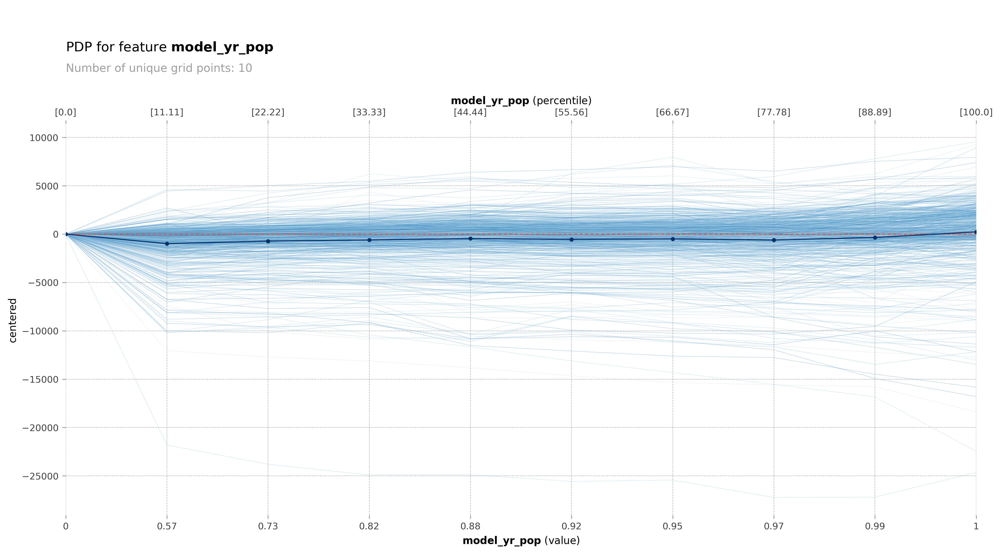

In [41]:
for feature in cont_feature_l:
    pdp_single_feature = pdp.PDPIsolate(
        model=cb_mdl, df=X_test, model_features=X_test.columns,\
        feature=feature, feature_name=feature, n_classes=0, n_jobs=-1)
    fig, axes = pdp_single_feature.plot(to_bins=True, plot_lines=True,\
                             frac_to_plot=0.01, show_percentile=True,\
                             engine='matplotlib')
    plt.show()

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

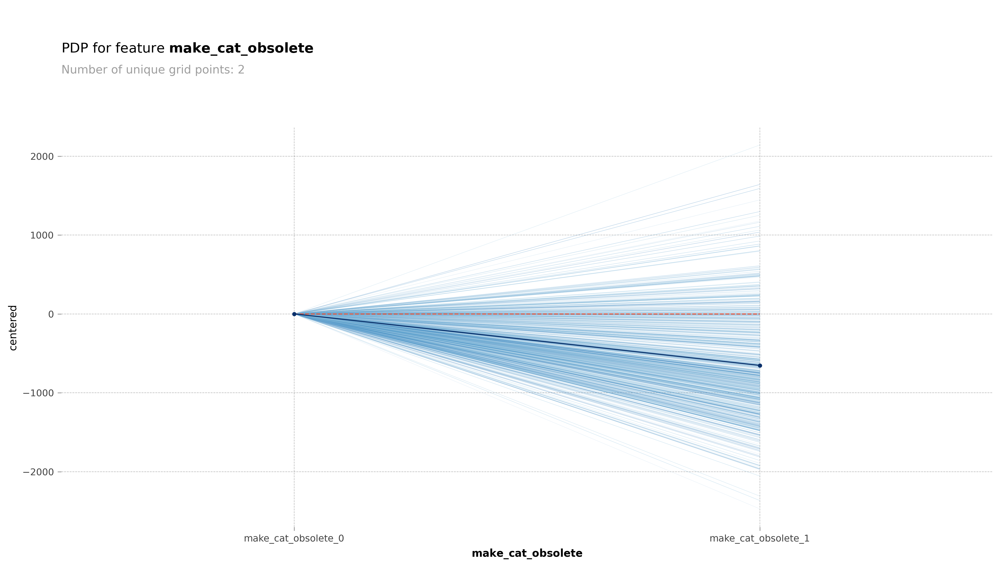

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

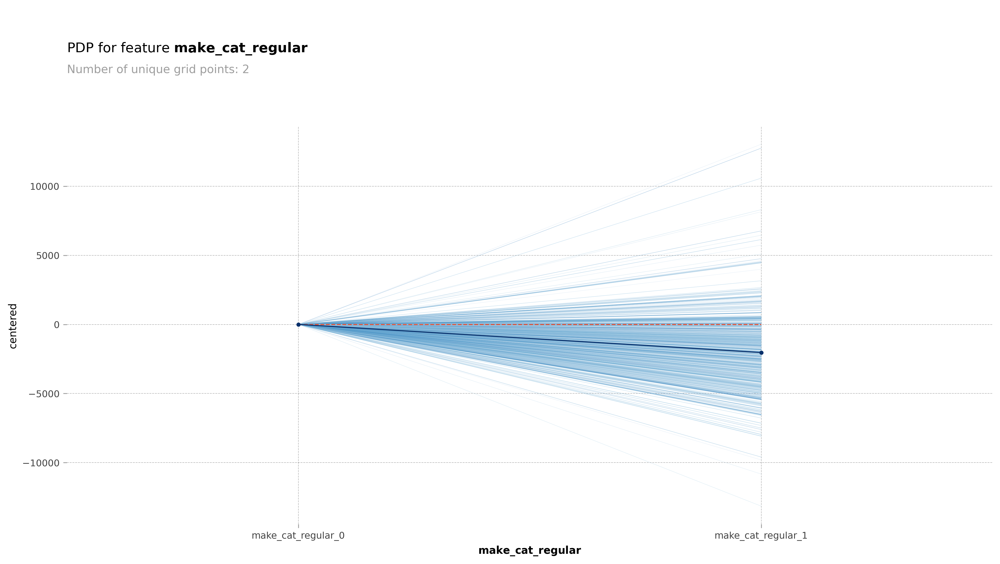

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

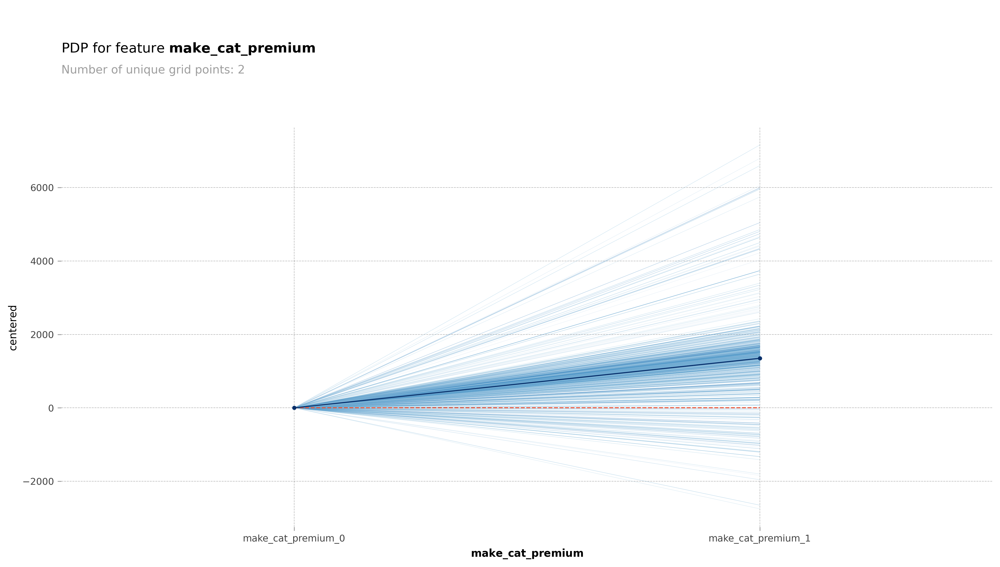

obtain pred_func from the provided model.


  0%|          | 0/2 [00:00<?, ?it/s]

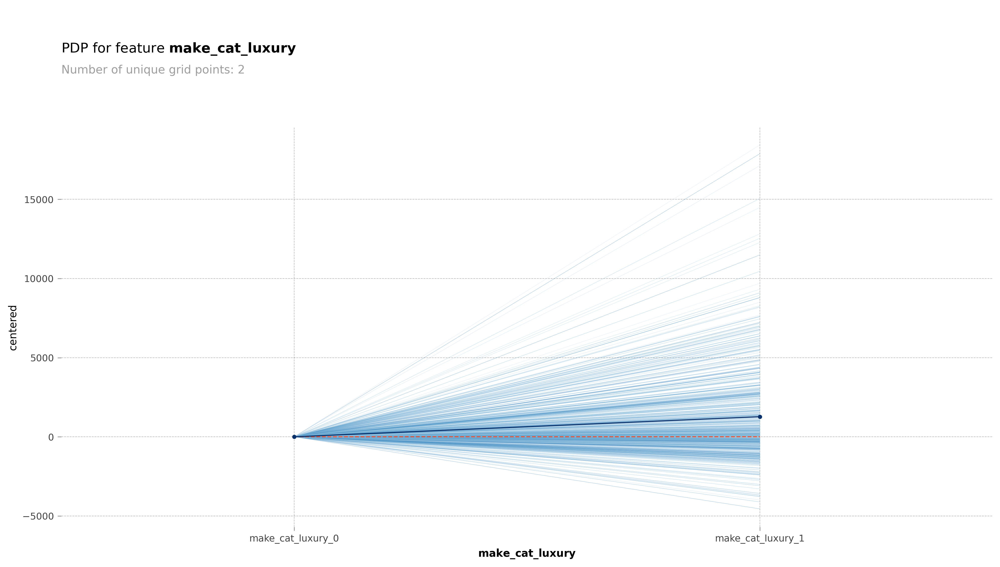

In [ ]:
for feature in make_cat_feature_l:
    pdp_single_feature = pdp.PDPIsolate(
        model=cb_mdl, df=X_test, model_features=X_test.columns,\
        feature=feature, feature_name=feature, n_classes=0, n_jobs=-1)
    fig, axes = pdp_single_feature.plot(to_bins=True, plot_lines=True,\
                             frac_to_plot=0.01, show_percentile=True,\
                             engine='matplotlib')
    plt.show()

In [52]:
%matplotlib inline
pdp_multi_feature = pdp.PDPIsolate(
    model=cb_mdl, df=X_test, model_features=X_test.columns,\
    feature=make_cat_feature_l, feature_name="make_cat",\
    n_classes=0, n_jobs=-1)

fig, axes = pdp_multi_feature.plot(plot_lines=True, plot_pts_dist=True,\
                         frac_to_plot=0.01, show_percentile=True)
fig.show()
plt.show()

obtain pred_func from the provided model.


  0%|          | 0/5 [00:00<?, ?it/s]

In [53]:
predict_plot = info_plots.PredictPlot(
    model=cb_mdl, df=X_test, model_features=X_test.columns, feature=make_cat_feature_l,\
    feature_name="make_cat", n_classes=0)

fig, _, _ = predict_plot.plot()
fig.show()

obtain pred_func from the provided model.


### SHAP Scatter Plot

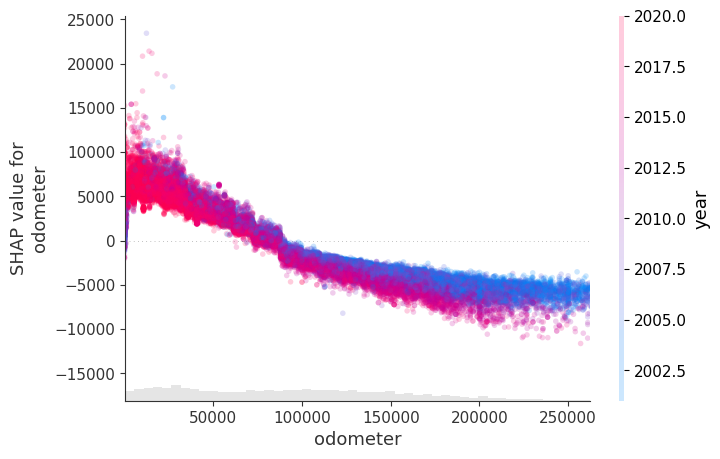

In [54]:
shap.plots.scatter(cb_shap[:,"odometer"], color=cb_shap[:,"year"],\
                   xmin="percentile(1)", xmax="percentile(99)", alpha=0.2)

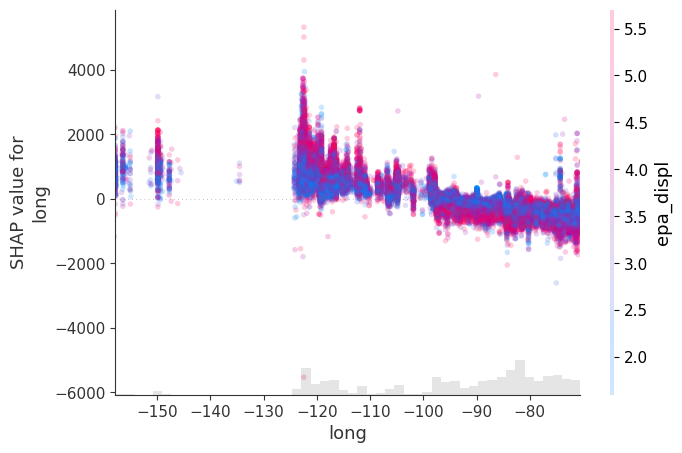

In [55]:
shap.plots.scatter(cb_shap[:,"long"], color=cb_shap[:,"epa_displ"],\
                   xmin="percentile(0.5)", xmax="percentile(99.5)", alpha=0.2,\
                   x_jitter=0.5)

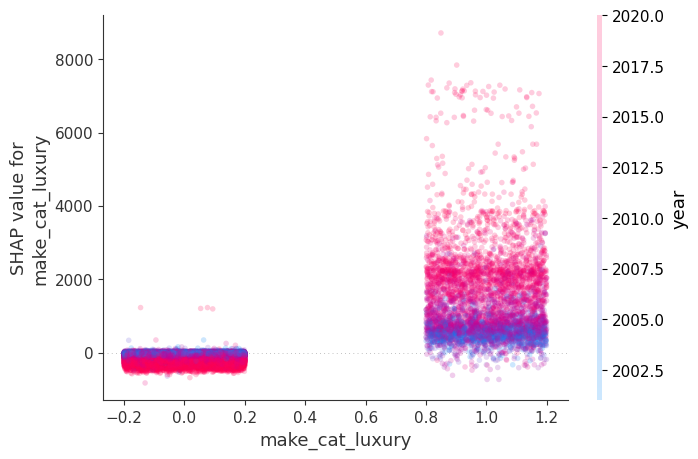

In [56]:
shap.plots.scatter(cb_shap[:,"make_cat_luxury"], color=cb_shap[:,"year"],\
                   x_jitter=0.4, alpha=0.2, hist=False)

### Accumulated Local Effects (ALE) Plots

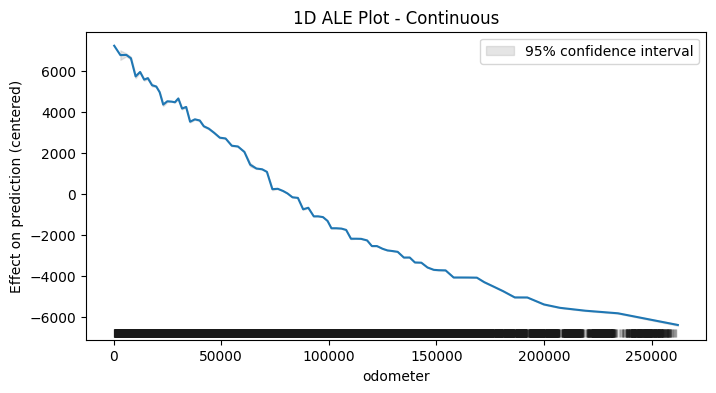

In [57]:
X_test_no_outliers = X_test[(X_test.year.quantile(.01) <= X_test.year) &\
                           (X_test.year <= X_test.year.quantile(.99)) &\
                           (X_test.odometer.quantile(.01) <= X_test.odometer) &\
                           (X_test.odometer <= X_test.odometer.quantile(.99))]

ale_effect = ale(X=X_test_no_outliers, model=cb_mdl, feature=['odometer'],\
                 feature_type='continuous', grid_size=80)
plt.show()

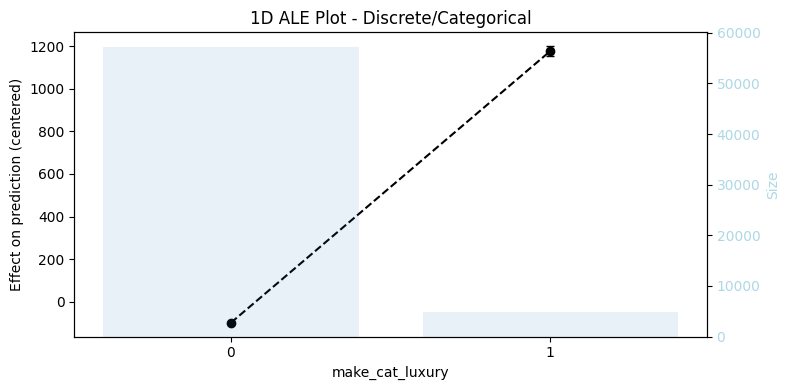

In [58]:
ale_effect = ale(X=X_test_no_outliers, model=cb_mdl, feature=['make_cat_luxury'],\
                 feature_type='discrete')
plt.show()

## Feature interactions

### SHAP Bar Plot with Clustering

In [59]:
X_samp = X.sample(frac=0.1)
y_samp = y.loc[X_samp.index]
clustering = shap.utils.hclust(X_samp, y_samp)

53it [01:03,  1.40s/it]


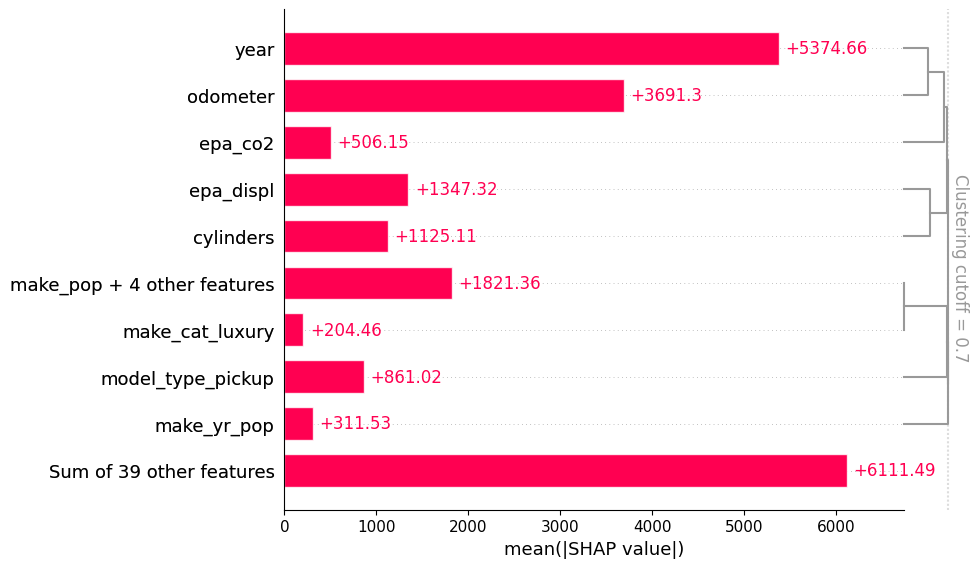

In [60]:
shap.plots.bar(cb_shap, clustering=clustering, clustering_cutoff=0.7)

### 2D Accumulated Local Effects (ALE) Plots

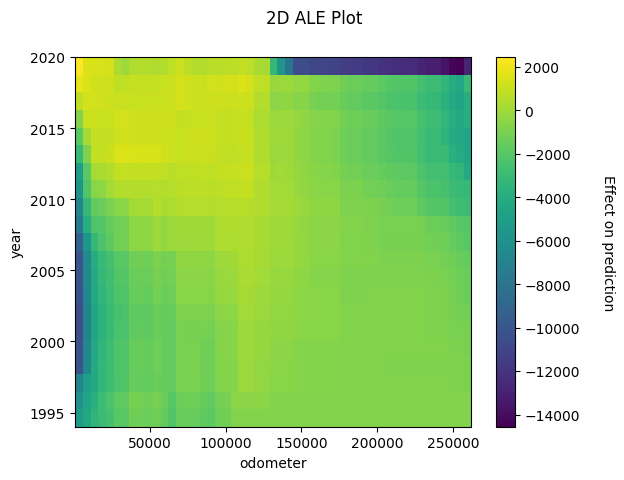

In [61]:
features_l = ["year", "odometer"]

mpl.rcParams["image.aspect"] = "auto"
ale_effect = ale(X=X_test_no_outliers, model=cb_mdl, feature=features_l,\
                 feature_type='continuous', grid_size=50, include_CI=False)
plt.show()

In [62]:
np.set_printoptions(suppress=True)
print(clustering)

[[  2.          21.           0.           2.        ]
 [ 22.          52.           0.           3.        ]
 [ 23.          53.           0.           4.        ]
 [ 24.          54.           0.           5.        ]
 [ 20.          55.           0.           6.        ]
 [  4.           7.           0.38680011   2.        ]
 [  9.          11.           0.4162052    2.        ]
 [ 43.          44.           0.42938936   2.        ]
 [ 15.          17.           0.45512533   2.        ]
 [ 12.          14.           0.52989352   2.        ]
 [  0.           1.           0.56387955   2.        ]
 [ 61.          62.           0.5797441    4.        ]
 [ 13.          63.           0.59420842   5.        ]
 [ 46.          49.           0.59832066   2.        ]
 [ 10.          57.           0.62910491   3.        ]
 [ 58.          66.           0.67684174   5.        ]
 [ 31.          56.           0.68109715   7.        ]
 [ 51.          65.           0.6936273    3.        ]
 [  5.    

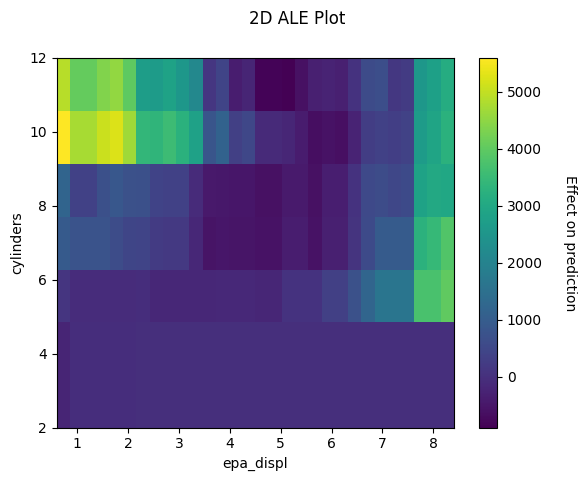

In [63]:
features_l = ["cylinders", "epa_displ"]

ale_effect = ale(X=X_test, model=cb_mdl, feature=features_l,\
                 feature_type='discrete', grid_size=50)
plt.show()

### PDP Interactions Plots

In [64]:
features_l = ["long", "lat"]

pdp_interaction_feature = pdp.PDPInteract(
    model=cb_mdl, df=X_test, model_features=X_test.columns, features=features_l,\
    feature_names=features_l, n_classes=0, num_grid_points=15, n_jobs=-1
)
fig, _ = pdp_interaction_feature.plot(
    plot_type='contour', plot_pdp=False)
fig.show()

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/15 [00:00<?, ?it/s]

obtain pred_func from the provided model.


  0%|          | 0/225 [00:00<?, ?it/s]

In [65]:
predict_interact = info_plots.InteractPredictPlot(
                      model=cb_mdl, df=X_test, features=features_l,\
                      feature_names=features_l, model_features=X_test.columns,\
                      n_classes=0, num_grid_points=15)
fig, _, _ = predict_interact.plot()
fig.show()

obtain pred_func from the provided model.


In [66]:
Xy_train = X_train.join(pd.Series(y_train, index=X_train.index, name='price'))

target_interaction = info_plots.InteractTargetPlot(\
                          df=Xy_train, target='price', features=features_l,
                          feature_names=features_l, num_grid_points=15)
fig, _, _ = target_interaction.plot()
fig.show()